#Исходная таблица:

partner | rep_date | monetary

* partner - уникальный идентификатор партнёра
* rep_date - дата пополнения
* monetary - нормализованное значение пополнения

#Промежуточная таблица:

partner | date_difference | monetary_coefficient | monetary_with_coefficient | monetary_coefficient

* date_difference - разнциа между заданной датой и датой пополнения
* monetary_coefficient - коэффициент актуальности, рассчитанный по формуле: 
  * 1 - date_difference // 90 [целое число] * 0.025
* monetary_with_coefficient - пополнение с учётом коэффициента

#Требуемые фичи:
partner | sum_monetary_w_coefficient  | sum_monetary_coefficient  | between_first_last | between_last_today 

* sum_monetary_w_coefficient - сумма нормализованных пополнений с учётом коэффициента актуальности
* sum_monetary_coefficient - количество пополнений с учётом коэффициента актуальности (сумма коэффициентов)
* between_first_last - количество дней между первой и последней покупкой (время жизни партнёра)
* between_last_today - количество дней между последней покупкой и запрашиваемым днём
* trans_freq - частота пополнений за время жизни партнёра

In [ ]:
import copy
import gdown
import pandas as pd
import numpy as np

In [ ]:
gdown.download(
	id='1x0kbU-dVEIzviaVoKu73gDEOTOoWEhK9',
	output="./data.parquet.gzip",
	quiet=False
)

Downloading...
From: https://drive.google.com/uc?id=1x0kbU-dVEIzviaVoKu73gDEOTOoWEhK9
To: /content/data.parquet.gzip
100%|██████████| 458M/458M [00:05<00:00, 87.8MB/s]


'./data.parquet.gzip'

In [ ]:
# date = sys.argv[1:]
# req_date = datetime.date(date)

df = pd.read_parquet('/content/data.parquet.gzip')
date = df['rep_date'].max()
req_date = pd.to_datetime(date)
# df = df[df['rep_date'] <= req_date]

In [ ]:
date_difference = copy.deepcopy(df)

date_difference["rep_date"] = (
    pd.to_datetime(date_difference["rep_date"])
)

In [ ]:
date_difference = (
    date_difference
      .groupby('partner', as_index=False)['rep_date']
      .agg(['first', 'last'])
      .reset_index()
)

In [ ]:
date_difference['between_first_last'] = (
    (date_difference['last'] - date_difference['first']).dt.days
)

In [ ]:
date_difference['between_last_today'] = (
    (req_date - date_difference['last'])
    .dt.days
)

In [ ]:
date_difference.drop(['first', 'last'], axis=1, inplace=True)

In [ ]:
date_difference

,partner,between_first_last,between_last_today
0,0,2576,8
1,1,2595,1
2,2,2525,22
3,3,2294,225
4,4,2548,59
...,...,...,...
1695379,1695379,1151,1252
1695380,1695380,454,2075
1695381,1695381,1998,363
1695382,1695382,246,2274


In [ ]:
mon_calc = copy.deepcopy(df)

In [ ]:
mon_calc["rep_date"] = pd.to_datetime(mon_calc["rep_date"]).dt.to_period('M').dt.to_timestamp()

In [ ]:
mon_calc.describe()

,partner,monetary
count,5.203280e+07,5.203280e+07
mean,6.609535e+05,2.349952e-08
std,4.614680e+05,1.418951e-04
min,0.000000e+00,0.000000e+00
25%,2.614480e+05,3.273979e-12
50%,5.743630e+05,1.242901e-11
75%,1.051004e+06,3.291440e-11
max,1.695383e+06,1.000000e+00


In [ ]:
mon_calc['date_difference'] = (req_date - mon_calc['rep_date']).dt.days

In [ ]:
mon_calc['monetary_coefficient'] = (1 - mon_calc['date_difference']//90 * 0.025)

In [ ]:
mon_calc['monetary_with_coefficient'] = (mon_calc['monetary'] * mon_calc['monetary_coefficient'])

In [ ]:
mon_calc = (
    mon_calc
      .groupby('partner')
      .agg(
          summ_monetary_w_coeff=('monetary_with_coefficient', 'sum'), 
          transactions_count_w_coeff=('monetary_coefficient', 'sum'),
          trans_number=('monetary', 'count')
      )
)

In [ ]:
result_df = (
    mon_calc
      .join(
          date_difference, 
          on='partner', 
          how='inner'
      )[['partner', 'summ_monetary_w_coeff',	'transactions_count_w_coeff', 'between_first_last',	'between_last_today', 'trans_number']]
)

period = (date-df['rep_date'].min()).days
result_df['trans_freq'] = (result_df['trans_number']/period)

In [ ]:
result_df

,partner,summ_monetary_w_coeff,transactions_count_w_coeff,between_first_last,between_last_today,trans_number,trans_freq
partner,,,,,,,
0,0,2.227586e-08,83.125,2576,8,138,0.052894
1,1,2.410450e-08,180.125,2595,1,267,0.102338
2,2,1.211692e-08,30.225,2525,22,58,0.022231
3,3,4.883613e-08,4.525,2294,225,7,0.002683
4,4,1.310426e-08,74.100,2548,59,179,0.068609
...,...,...,...,...,...,...,...
1695379,1695379,2.755205e-12,1.975,1151,1252,4,0.001533
1695380,1695380,1.929008e-08,1.050,454,2075,3,0.001150
1695381,1695381,1.433148e-08,11.600,1998,363,23,0.008816


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
result_df.describe()

,partner,summ_monetary_w_coeff,transactions_count_w_coeff,between_first_last,between_last_today,trans_number,trans_freq
count,1.695384e+06,1.695384e+06,1.695384e+06,1.695384e+06,1.695384e+06,1.695384e+06,1.695384e+06
mean,8.476915e+05,3.104561e-07,2.088567e+01,8.110342e+02,8.502067e+02,3.069086e+01,1.176346e-02
std,4.894153e+05,3.350067e-04,3.764435e+01,8.363505e+02,8.440107e+02,5.376033e+01,2.060572e-02
min,0.000000e+00,1.230547e-33,2.750000e-01,0.000000e+00,0.000000e+00,1.000000e+00,3.832886e-04
25%,4.238458e+05,3.339459e-11,1.900000e+00,9.600000e+01,3.700000e+01,3.000000e+00,1.149866e-03
50%,8.476915e+05,2.428307e-10,6.250000e+00,4.800000e+02,5.740000e+02,1.000000e+01,3.832886e-03
75%,1.271537e+06,1.134380e-09,2.185000e+01,1.358000e+03,1.543000e+03,3.300000e+01,1.264852e-02
max,1.695383e+06,4.250000e-01,7.312250e+02,2.609000e+03,2.608000e+03,1.138000e+03,4.361824e-01


# Интересные клиенты

In [ ]:
result_df[result_df['trans_freq'] > 0.43]

,partner,summ_monetary_w_coeff,transactions_count_w_coeff,between_first_last,between_last_today,trans_number,trans_freq
partner,,,,,,,
147154,147154,0.000002,731.225,2609,0,1138,0.436182


In [ ]:
result_df[result_df['summ_monetary_w_coeff'] > 0.4]

,partner,summ_monetary_w_coeff,transactions_count_w_coeff,between_first_last,between_last_today,trans_number,trans_freq
partner,,,,,,,
419093,419093,0.425,109.125,2595,2,140,0.05366


In [ ]:
result_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1695384 entries, 0 to 1695383
Data columns (total 7 columns):
 #   Column                      Dtype  
---  ------                      -----  
 0   partner                     int64  
 1   summ_monetary_w_coeff       float64
 2   transactions_count_w_coeff  float64
 3   between_first_last          int64  
 4   between_last_today          int64  
 5   trans_number                int64  
 6   trans_freq                  float64
dtypes: float64(3), int64(4)
memory usage: 103.5 MB


## Анализ фичи "Summ monetary with coefficient"

Сырой график распределения фичи

<Axes: xlabel='summ_monetary_w_coeff', ylabel='Count'>

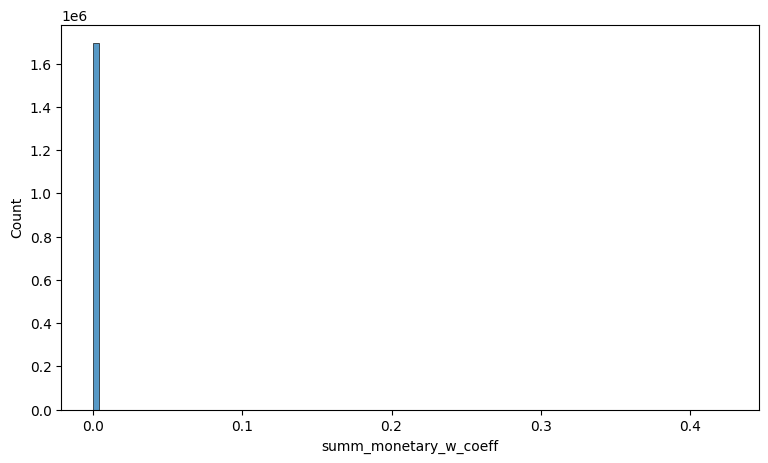

In [ ]:
plt.figure(figsize=(9,5))
sns.histplot(data=result_df, x="summ_monetary_w_coeff", bins=100)

Распределение основного диапазона значений фичи

<Axes: xlabel='summ_monetary_w_coeff', ylabel='Count'>

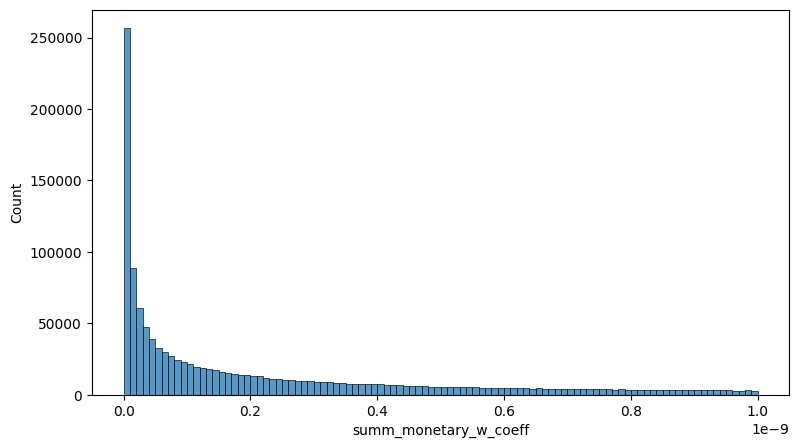

In [ ]:
plt.figure(figsize=(9,5))
sns.histplot(data=result_df[result_df['summ_monetary_w_coeff']< 0.000000001], x="summ_monetary_w_coeff", bins=100)

Распределение по логарифмической шкале

<Axes: xlabel='summ_monetary_w_coeff_log', ylabel='Count'>

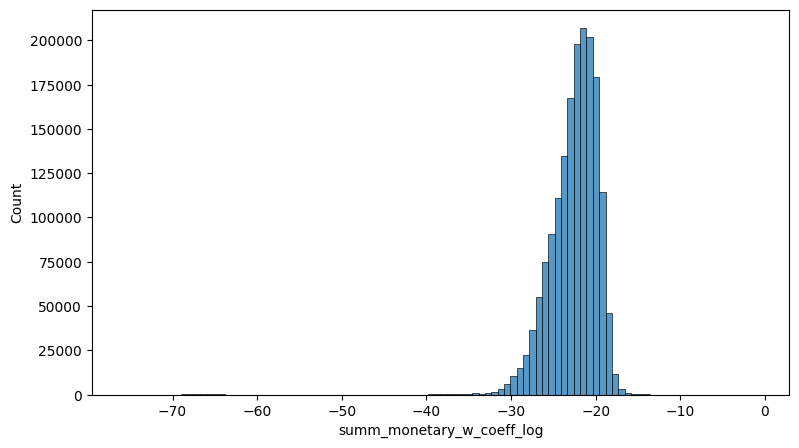

In [ ]:
result_df['summ_monetary_w_coeff_log'] = np.log(result_df['summ_monetary_w_coeff'])
plt.figure(figsize=(9,5))
sns.histplot(data=result_df, x="summ_monetary_w_coeff_log", bins=100)

от -70 до -60 наблюдается "остров" значений, рассмотрим его отдельно

<Axes: xlabel='summ_monetary_w_coeff_log', ylabel='Count'>

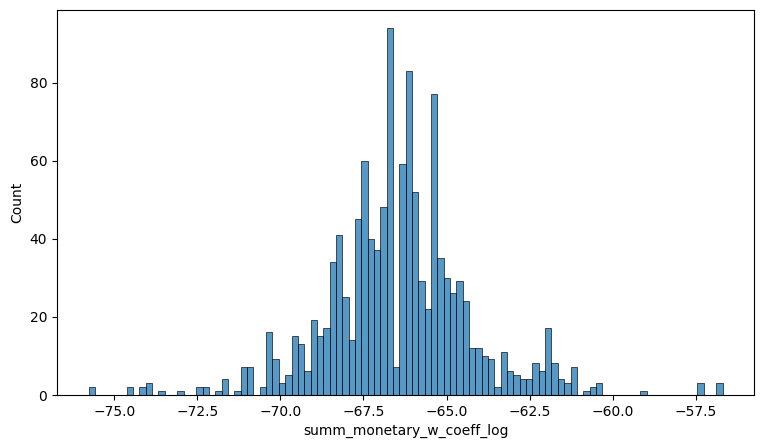

In [ ]:
result_df['summ_monetary_w_coeff_log'] = np.log(result_df['summ_monetary_w_coeff'])
plt.figure(figsize=(9,5))
sns.histplot(data=result_df[result_df['summ_monetary_w_coeff_log'] < -50], x="summ_monetary_w_coeff_log", bins=100)

ГИПОТЕЗА: данный остров есть отдельный кластер, форма распределения есть нормальная

<Axes: xlabel='summ_monetary_w_coeff_log'>

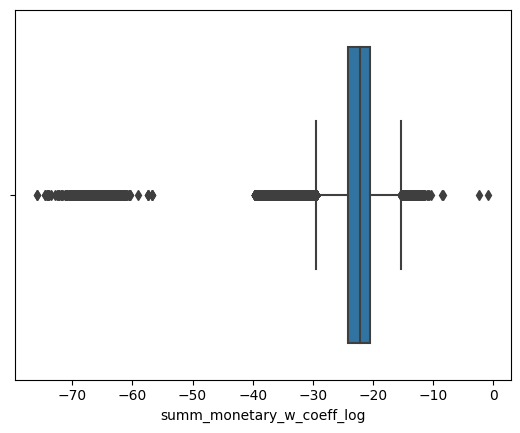

In [ ]:
sns.boxplot(x=result_df["summ_monetary_w_coeff_log"])

"Остров" видно даже с материка

ВЫВОД: Для модели МО будем использовать прологарифмированные значения

## Анализ фичи "transactions_count_w_coeff"



<Axes: xlabel='transactions_count_w_coeff', ylabel='Count'>

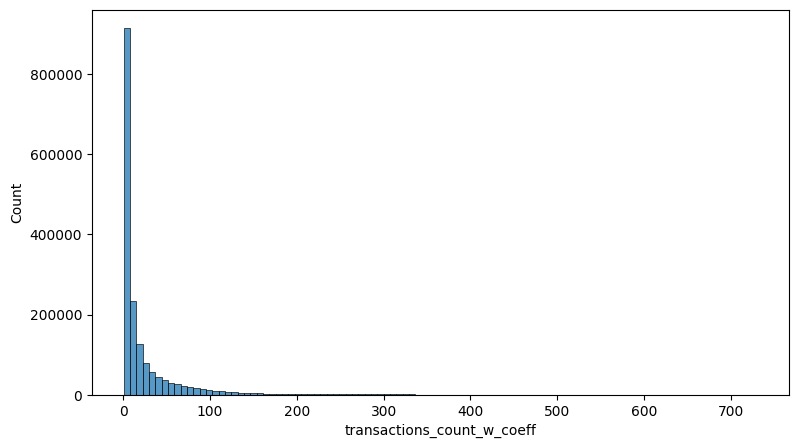

In [ ]:
plt.figure(figsize=(9,5))
sns.histplot(data=result_df, x="transactions_count_w_coeff", bins=100)

Снова логарифмируем

<Axes: xlabel='transactions_count_w_coeff_log', ylabel='Count'>

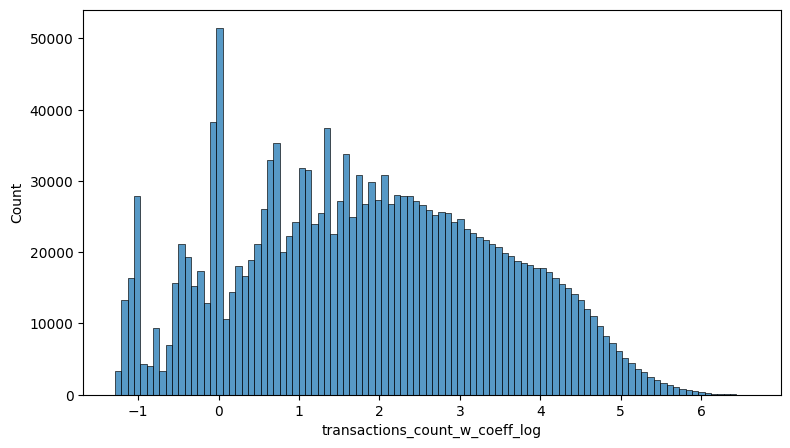

In [ ]:
result_df['transactions_count_w_coeff_log'] = np.log(result_df['transactions_count_w_coeff'])
plt.figure(figsize=(9,5))
sns.histplot(data=result_df, x="transactions_count_w_coeff_log", bins=100)

Смотрим коробку

<Axes: xlabel='transactions_count_w_coeff_log'>

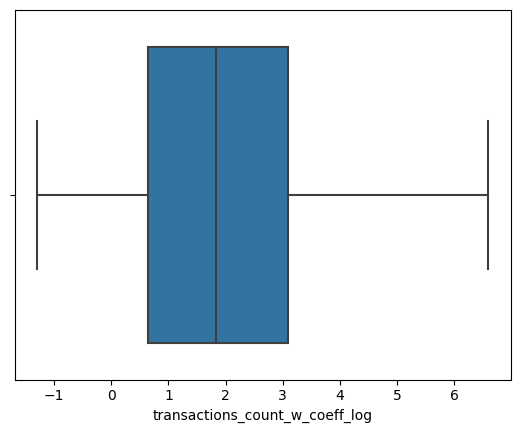

In [ ]:
sns.boxplot(x=result_df["transactions_count_w_coeff_log"])

ВЫВОД: Для модели МО будем использовать прологарифмированные значения

<Axes: xlabel='trans_freq', ylabel='Count'>

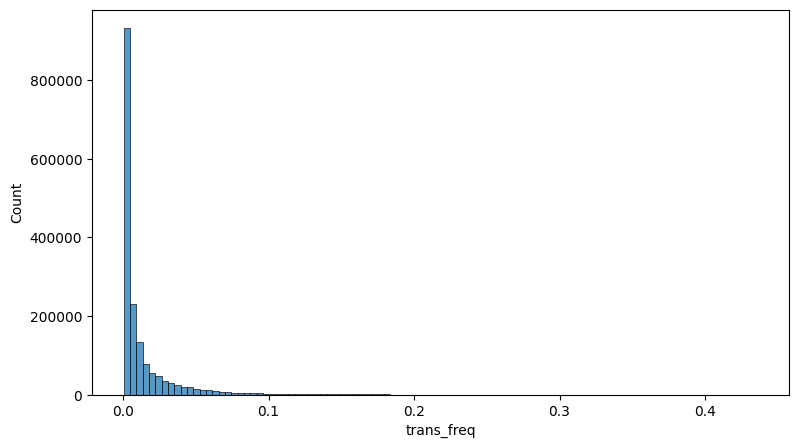

In [ ]:
plt.figure(figsize=(9,5))
sns.histplot(data=result_df, x="trans_freq", bins=100)

<Axes: xlabel='trans_freq_log', ylabel='Count'>

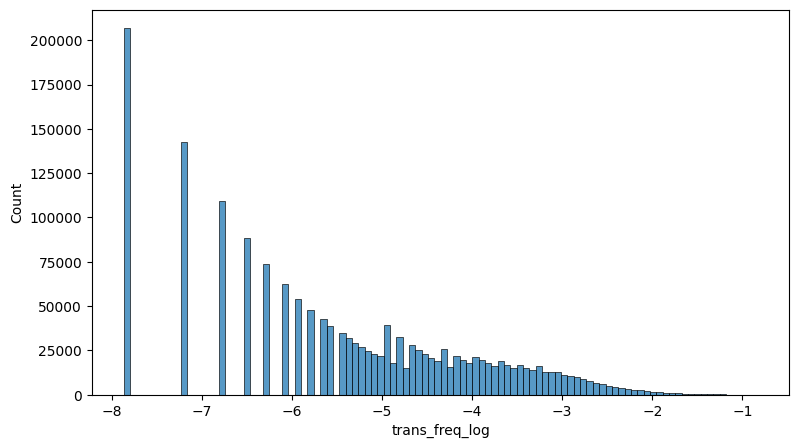

In [ ]:
result_df['trans_freq_log'] = np.log(result_df['trans_freq'])
plt.figure(figsize=(9,5))
sns.histplot(data=result_df, x="trans_freq_log", bins=100)

<Axes: xlabel='trans_freq_log'>

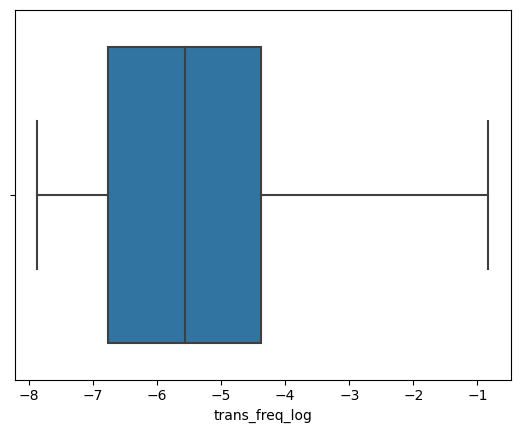

In [ ]:
sns.boxplot(x=result_df["trans_freq_log"])

## Анализ фичи "between_first_last"

<Axes: xlabel='between_first_last', ylabel='Count'>

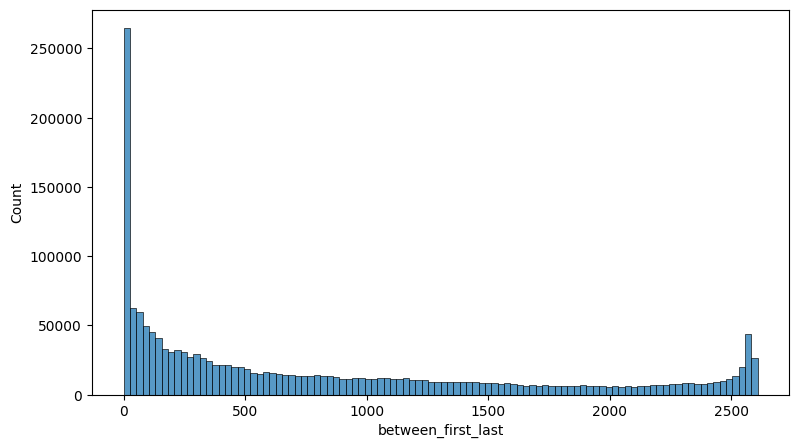

In [ ]:
plt.figure(figsize=(9,5))
sns.histplot(data=result_df, x="between_first_last", bins=100)

<Axes: xlabel='between_first_last_log', ylabel='Count'>

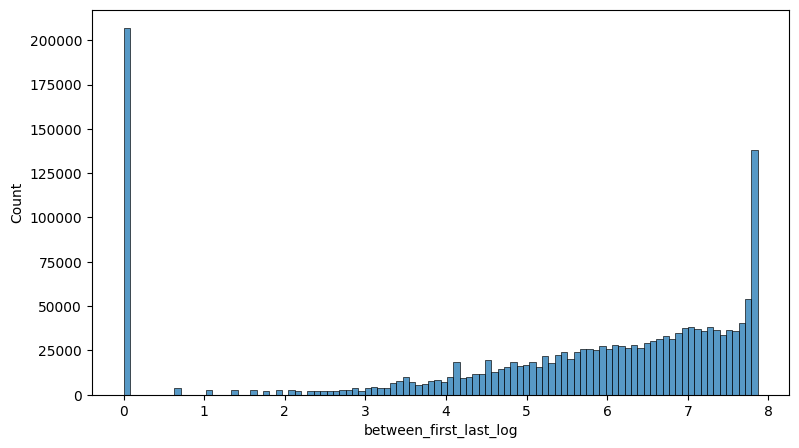

In [ ]:
result_df['between_first_last_log'] = np.log1p(result_df['between_first_last'])
plt.figure(figsize=(9,5))
sns.histplot(data=result_df, x="between_first_last_log", bins=100)

<Axes: xlabel='between_first_last', ylabel='Count'>

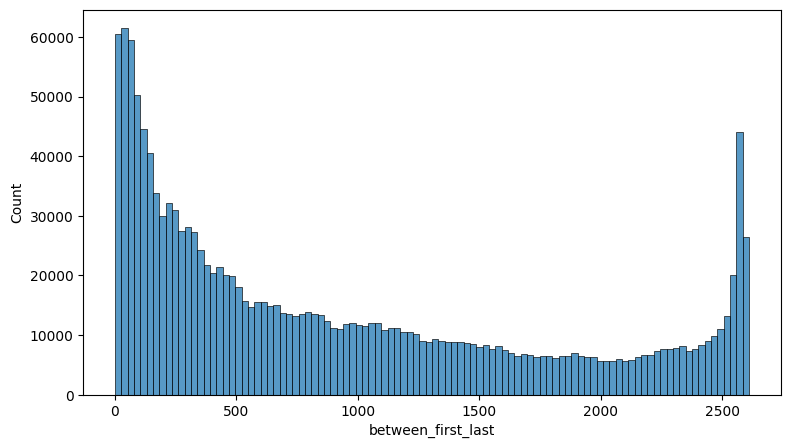

In [ ]:
plt.figure(figsize=(9,5))
sns.histplot(data=result_df[result_df["between_first_last"] > 0], x="between_first_last", bins=100)

"Логическим глазом" 👁 можно выделить следующие кластеры по сроку активности клиента:
1. Однодневки (Срок жизни = ноль дней)
2. Середнячки (Срок жизни около 0~850 дней)
3. Крепыши (Срок жизни 1000~2000 дней)
4. Долгожители (В районе 2000+ дней)



ВЫВОД: Значение кластеризуется на необработанных данных, модель кластеризации будет использовать чистые данные по данному признаку

<Axes: xlabel='between_first_last'>

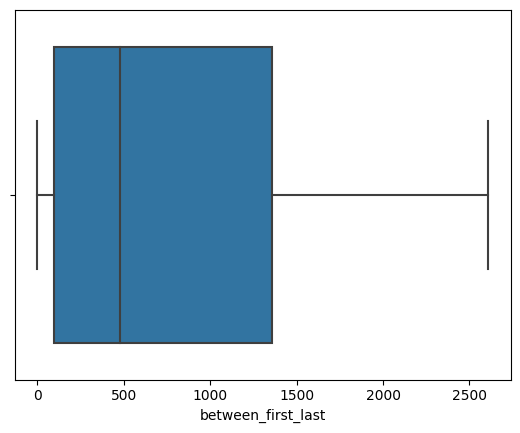

In [ ]:
sns.boxplot(x=result_df["between_first_last"])

In [ ]:
result_df['lifetime'] = result_df['between_first_last']/period
result_df

,partner,summ_monetary_w_coeff,transactions_count_w_coeff,between_first_last,between_last_today,trans_number,trans_freq,summ_monetary_w_coeff_log,transactions_count_w_coeff_log,trans_freq_log,between_first_last_log,lifetime
partner,,,,,,,,,,,,
0,0,2.227586e-08,83.125,2576,8,138,0.052894,-17.619762,4.420345,-2.939469,7.854381,0.987351
1,1,2.410450e-08,180.125,2595,1,267,0.102338,-17.540867,5.193651,-2.279474,7.861727,0.994634
2,2,1.211692e-08,30.225,2525,22,58,0.022231,-18.228663,3.408669,-3.806279,7.834392,0.967804
3,3,4.883613e-08,4.525,2294,225,7,0.002683,-16.834796,1.509618,-5.920812,7.738488,0.879264
4,4,1.310426e-08,74.100,2548,59,179,0.068609,-18.150329,4.305416,-2.679336,7.843456,0.976619
...,...,...,...,...,...,...,...,...,...,...,...,...
1695379,1695379,2.755205e-12,1.975,1151,1252,4,0.001533,-26.617529,0.680568,-6.480428,7.049255,0.441165
1695380,1695380,1.929008e-08,1.050,454,2075,3,0.001150,-17.763675,0.048790,-6.768110,6.120297,0.174013
1695381,1695381,1.433148e-08,11.600,1998,363,23,0.008816,-18.060807,2.451005,-4.731228,7.600402,0.765811


<Axes: xlabel='lifetime', ylabel='Count'>

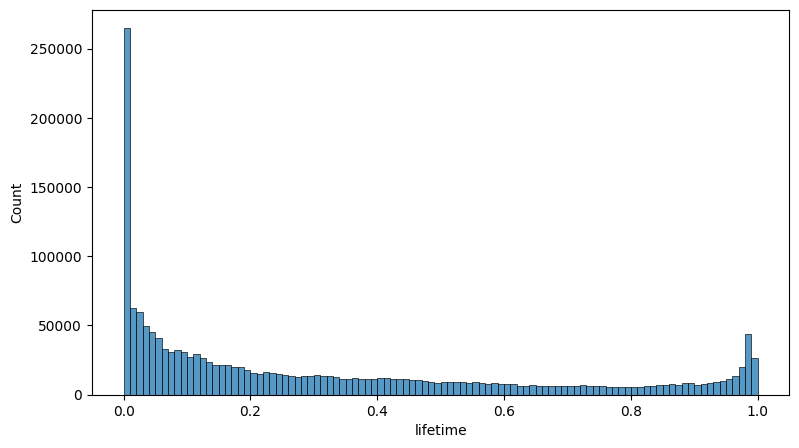

In [ ]:
plt.figure(figsize=(9,5))
sns.histplot(data=result_df, x="lifetime", bins=100)

In [ ]:
result_df.describe()

,partner,summ_monetary_w_coeff,transactions_count_w_coeff,between_first_last,between_last_today,trans_number,trans_freq,summ_monetary_w_coeff_log,transactions_count_w_coeff_log,trans_freq_log,between_first_last_log,lifetime
count,1.695384e+06,1.695384e+06,1.695384e+06,1.695384e+06,1.695384e+06,1.695384e+06,1.695384e+06,1.695384e+06,1.695384e+06,1.695384e+06,1.695384e+06,1.695384e+06
mean,8.476915e+05,3.104561e-07,2.088567e+01,8.110342e+02,8.502067e+02,3.069086e+01,1.176346e-02,-2.256763e+01,1.876767e+00,-5.517747e+00,5.416640e+00,3.108602e-01
std,4.894153e+05,3.350067e-04,3.764435e+01,8.363505e+02,8.440107e+02,5.376033e+01,2.060572e-02,2.863724e+00,1.599607e+00,1.515756e+00,2.415669e+00,3.205636e-01
min,0.000000e+00,1.230547e-33,2.750000e-01,0.000000e+00,0.000000e+00,1.000000e+00,3.832886e-04,-7.577785e+01,-1.290984e+00,-7.866722e+00,0.000000e+00,0.000000e+00
25%,4.238458e+05,3.339459e-11,1.900000e+00,9.600000e+01,3.700000e+01,3.000000e+00,1.149866e-03,-2.412263e+01,6.418539e-01,-6.768110e+00,4.574711e+00,3.679571e-02
50%,8.476915e+05,2.428307e-10,6.250000e+00,4.800000e+02,5.740000e+02,1.000000e+01,3.832886e-03,-2.213866e+01,1.832581e+00,-5.564137e+00,6.175867e+00,1.839785e-01
75%,1.271537e+06,1.134380e-09,2.185000e+01,1.358000e+03,1.543000e+03,3.300000e+01,1.264852e-02,-2.059718e+01,3.084201e+00,-4.370215e+00,7.214504e+00,5.205059e-01
max,1.695383e+06,4.250000e-01,7.312250e+02,2.609000e+03,2.608000e+03,1.138000e+03,4.361824e-01,-8.556661e-01,6.594721e+00,-8.296947e-01,7.867106e+00,1.000000e+00


## Анализ фичи "between_last_today"

<Axes: xlabel='between_last_today', ylabel='Count'>

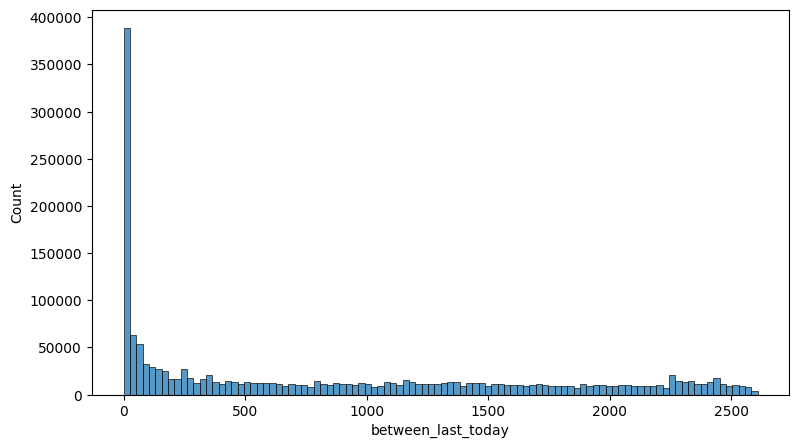

In [ ]:
plt.figure(figsize=(9,5))
sns.histplot(data=result_df, x="between_last_today", bins=100)

<Axes: xlabel='between_last_today_log', ylabel='Count'>

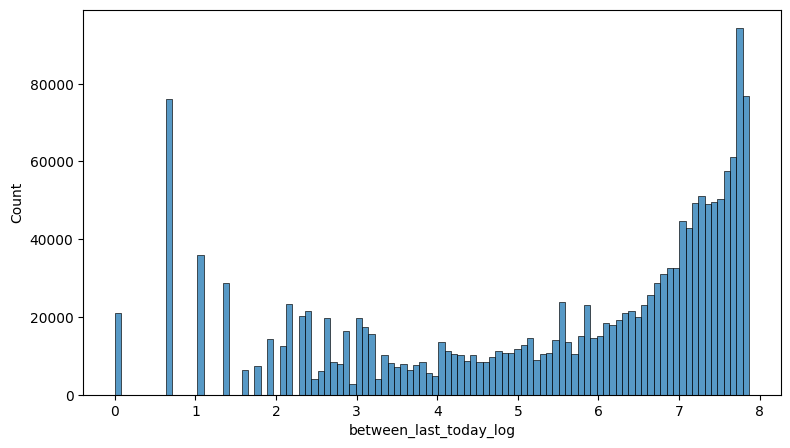

In [ ]:
result_df['between_last_today_log'] = np.log1p(result_df['between_last_today'])
plt.figure(figsize=(9,5))
sns.histplot(data=result_df, x="between_last_today_log", bins=100)

In [ ]:
import plotly.express as px
fig = px.histogram(result_df, x="between_last_today_log")
fig.show()

"Логическим глазом" (👁_👁) по графику логарифмированных значений признака давности послдней операции клиента выделяются следующие кластеры:
1. Диапазон слева
2. Диапазон середина
3. Диапазон справа

ВЫВОД: Для модели МО будем использовать прологарифмированные значений

<Axes: xlabel='between_last_today_log'>

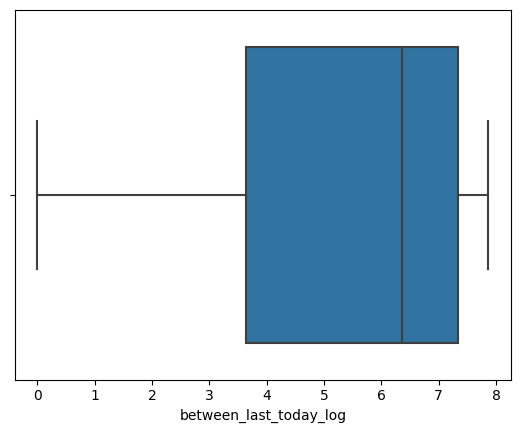

In [ ]:
sns.boxplot(x=result_df["between_last_today_log"])

# Связь между признаками

Рассмотрим связь между значениями фичей попарно.

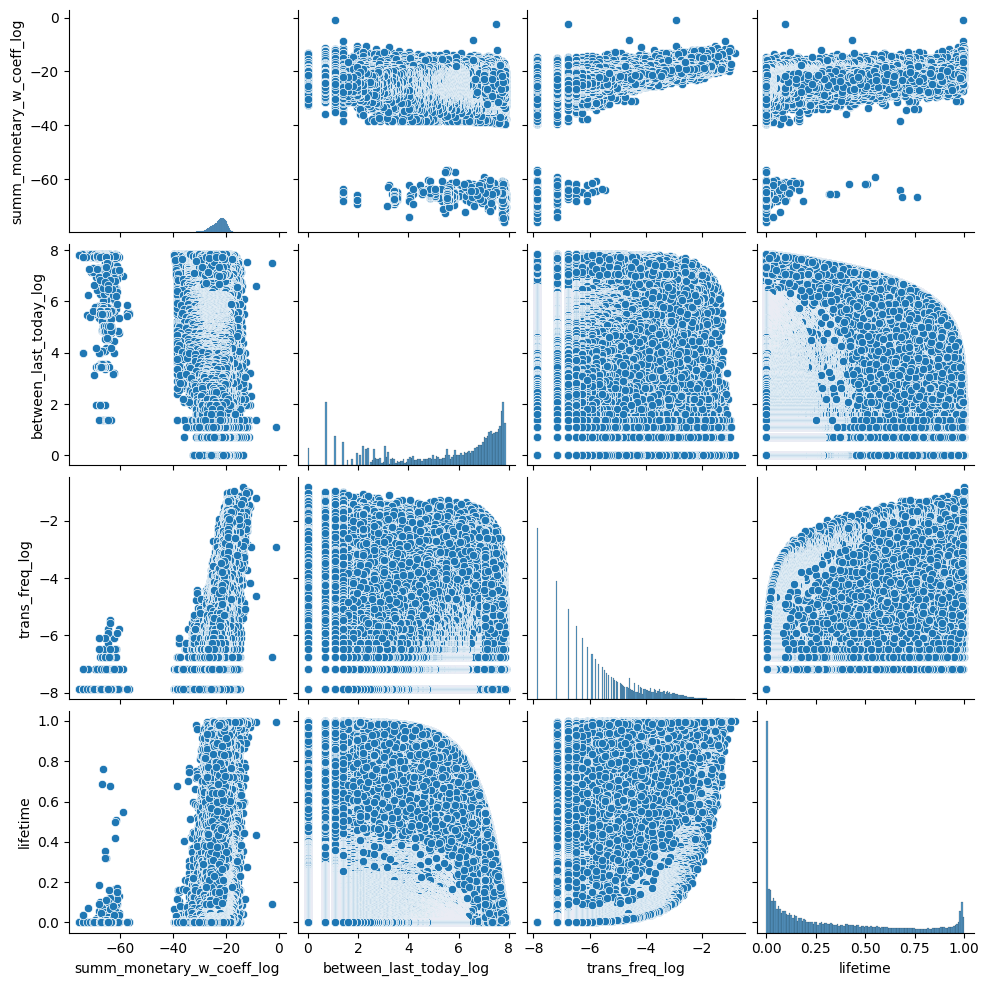

In [ ]:
sns.pairplot(data = result_df[['summ_monetary_w_coeff_log', 'between_last_today_log', 'trans_freq_log', 'lifetime']])

Посмотрим значения коэффицентов корреляции для используемых фичей.

In [ ]:
result_df

,partner,summ_monetary_w_coeff,transactions_count_w_coeff,between_first_last,between_last_today,trans_number,trans_freq,summ_monetary_w_coeff_log,transactions_count_w_coeff_log,trans_freq_log,between_first_last_log,lifetime,between_last_today_log
partner,,,,,,,,,,,,,
0,0,2.227586e-08,83.125,2576,8,138,0.052894,-17.619762,4.420345,-2.939469,7.854381,0.987351,2.197225
1,1,2.410450e-08,180.125,2595,1,267,0.102338,-17.540867,5.193651,-2.279474,7.861727,0.994634,0.693147
2,2,1.211692e-08,30.225,2525,22,58,0.022231,-18.228663,3.408669,-3.806279,7.834392,0.967804,3.135494
3,3,4.883613e-08,4.525,2294,225,7,0.002683,-16.834796,1.509618,-5.920812,7.738488,0.879264,5.420535
4,4,1.310426e-08,74.100,2548,59,179,0.068609,-18.150329,4.305416,-2.679336,7.843456,0.976619,4.094345
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1695379,1695379,2.755205e-12,1.975,1151,1252,4,0.001533,-26.617529,0.680568,-6.480428,7.049255,0.441165,7.133296
1695380,1695380,1.929008e-08,1.050,454,2075,3,0.001150,-17.763675,0.048790,-6.768110,6.120297,0.174013,7.638198
1695381,1695381,1.433148e-08,11.600,1998,363,23,0.008816,-18.060807,2.451005,-4.731228,7.600402,0.765811,5.897154


In [ ]:
cm = sns.color_palette("vlag", as_cmap=True)
data_num=result_df[['summ_monetary_w_coeff_log', 'between_last_today_log', 'trans_freq_log', 'lifetime']]
data_num.corr().style.background_gradient(cmap=cm, vmin = -1, vmax=1)

,summ_monetary_w_coeff_log,between_last_today_log,trans_freq_log,lifetime
summ_monetary_w_coeff_log,1.000000,-0.368844,0.583085,0.519142
between_last_today_log,-0.368844,1.000000,-0.431146,-0.376248
trans_freq_log,0.583085,-0.431146,1.000000,0.710416
lifetime,0.519142,-0.376248,0.710416,1.000000


Учитывая кореляцию между признаками, выбраны следующие признаки для сегментации клиентов:
- between_last_today_log (модифицированный recently)	
- lifetime (модифицированный frequency)
- summ_monetary_w_coeff_log	(модифицированный monetary)

Рассмотрев гистограмму распределения lifetime можно выделить следующие фрагменты:
1. От 0 до 0.25
2. От 0.25 до 0.6
3. От 0.6 до 0.8
4. От 0.8 до 1

Рассмотрев гистограмму распределения summ_monetary_w_coeff_log можно выделить следующие фрагменты:
1. От -80 до -40
2. От -40 до -25
3. От -25 до -20
4. От -20 до 0

Рассмотрев гистограмму распределения between_last_today_log можно выделить следующие фрагменты:
1. От 0 до 3.5 (~1 мес.)
2. От 3.5 до 6 (~1 год)
3. От 6 до 8 (> 1 года)

In [ ]:
#from sklearn.cluster import KMeans
#from sklearn import metrics
#from sklearn.decomposition import PCA
#from sklearn.preprocessing import StandardScaler

In [ ]:
#scaler = StandardScaler()
#X_norm = scaler.fit_transform(data_num)

In [ ]:
#pca = PCA(n_components=3)
#X_new = pca.fit_transform(X_norm)

In [ ]:
import plotly.express as px
#fig = px.scatter(result_df, x="summ_monetary_w_coeff_log", y="between_last_today_log")
#fig.show(renderer="jpeg")

![image.png](attachment:b93299ee-0f8b-4737-8068-1da82535e173.png)

In [ ]:
result_df.loc[
    (result_df['summ_monetary_w_coeff_log'] < -40)&
    (result_df['between_last_today_log'] < 3.5),
    'sector'] = 1
result_df.loc[
    (result_df['summ_monetary_w_coeff_log'] < -40)&
    (result_df['between_last_today_log'] >= 3.5)&
    (result_df['between_last_today_log'] < 6),
    'sector'] = 2
result_df.loc[
    (result_df['summ_monetary_w_coeff_log'] < -40)&
    (result_df['between_last_today_log'] >= 6),
    'sector'] = 3

result_df.loc[
    (result_df['summ_monetary_w_coeff_log'] >= -40)&
    (result_df['summ_monetary_w_coeff_log'] < -25)&
    (result_df['between_last_today_log'] < 3.5),
    'sector'] = 4
result_df.loc[
    (result_df['summ_monetary_w_coeff_log'] >= -40)&
    (result_df['summ_monetary_w_coeff_log'] < -25)&
    (result_df['between_last_today_log'] >= 3.5)&
    (result_df['between_last_today_log'] < 6),
    'sector'] = 5
result_df.loc[
    (result_df['summ_monetary_w_coeff_log'] >= -40)&
    (result_df['summ_monetary_w_coeff_log'] < -25)&
    (result_df['between_last_today_log'] >= 6),
    'sector'] = 6

result_df.loc[
    (result_df['summ_monetary_w_coeff_log'] >= -25)&
    (result_df['summ_monetary_w_coeff_log'] < -20)&
    (result_df['between_last_today_log'] < 3.5),
    'sector'] = 7
result_df.loc[
    (result_df['summ_monetary_w_coeff_log'] >= -25)&
    (result_df['summ_monetary_w_coeff_log'] < -20)&
    (result_df['between_last_today_log'] >= 3.5)&
    (result_df['between_last_today_log'] < 6),
    'sector'] = 8
result_df.loc[
    (result_df['summ_monetary_w_coeff_log'] >= -25)&
    (result_df['summ_monetary_w_coeff_log'] < -20)&
    (result_df['between_last_today_log'] >= 3.5)&
    (result_df['between_last_today_log'] >= 6),
    'sector'] = 9


result_df.loc[
    (result_df['summ_monetary_w_coeff_log'] >= -20)&
    (result_df['between_last_today_log'] < 3.5),
    'sector'] = 10
result_df.loc[
    (result_df['summ_monetary_w_coeff_log'] >= -20)&
    (result_df['between_last_today_log'] > 3.5)&
    (result_df['between_last_today_log'] < 6),
    'sector'] = 11
result_df.loc[
    (result_df['summ_monetary_w_coeff_log'] >= -20)&
    (result_df['between_last_today_log'] >= 3.5)&
    (result_df['between_last_today_log'] >= 6),
    'sector'] = 12

In [ ]:
result_df

,partner,summ_monetary_w_coeff,transactions_count_w_coeff,between_first_last,between_last_today,trans_number,trans_freq,summ_monetary_w_coeff_log,transactions_count_w_coeff_log,trans_freq_log,between_first_last_log,lifetime,between_last_today_log,sector
partner,,,,,,,,,,,,,,
0,0,2.227586e-08,83.125,2576,8,138,0.052894,-17.619762,4.420345,-2.939469,7.854381,0.987351,2.197225,10.0
1,1,2.410450e-08,180.125,2595,1,267,0.102338,-17.540867,5.193651,-2.279474,7.861727,0.994634,0.693147,10.0
2,2,1.211692e-08,30.225,2525,22,58,0.022231,-18.228663,3.408669,-3.806279,7.834392,0.967804,3.135494,10.0
3,3,4.883613e-08,4.525,2294,225,7,0.002683,-16.834796,1.509618,-5.920812,7.738488,0.879264,5.420535,11.0
4,4,1.310426e-08,74.100,2548,59,179,0.068609,-18.150329,4.305416,-2.679336,7.843456,0.976619,4.094345,11.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1695379,1695379,2.755205e-12,1.975,1151,1252,4,0.001533,-26.617529,0.680568,-6.480428,7.049255,0.441165,7.133296,6.0
1695380,1695380,1.929008e-08,1.050,454,2075,3,0.001150,-17.763675,0.048790,-6.768110,6.120297,0.174013,7.638198,12.0
1695381,1695381,1.433148e-08,11.600,1998,363,23,0.008816,-18.060807,2.451005,-4.731228,7.600402,0.765811,5.897154,11.0


In [ ]:
#import plotly.express as px
#fig = px.scatter(result_df, x="summ_monetary_w_coeff_log", y="between_last_today_log", color="sector")
#fig.show(renderer="jpeg")

In [ ]:
result_df['sector'].value_counts()

9.0     662427
7.0     247222
6.0     219273
8.0     216864
10.0    142880
11.0     82313
5.0      54608
12.0     46787
4.0      21803
3.0        753
1.0        232
2.0        222
Name: sector, dtype: int64

<Axes: ylabel='sector'>

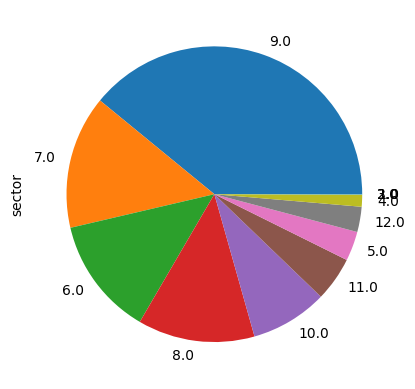

In [ ]:
result_df['sector'].value_counts().plot(kind='pie')

- **1.**	Недавние бедняки (новички), с течением времени могут перетекать в 4,7, 10, в зависимости от сумм пополнений, или в 2,3 из-за бездействия.
- **2.**	Годовалые бедняки, с теч. вр. могут перетекать в 1,3 групп
- **3.**	Давние бедняки (мертвецы), с теч. вр. могут перетекать в 1 группу
- **4.**	Недавний низкий класс, С течением времени могут перетекать в 5
- **5.**	Годовалый низкий класс, С течением времени могут перетекать в 4,6
- **6.** Давний низкий класс (мертвецы), С течением времени могут перетекать в 4
- **7.**	Недавний средний класс, С течением времени могут перетекать в 8
- **8.**	Годовалый средний класс, С течением времени могут перетекать в 7,9
- **9.**	Давний средний класс (мертвецы), С течением времени могут перетекать в 7
- **10.**	Лояльные недавние богачи, VIP, с теч. вр. могут перетекать в 11,12
- **11.**	Лояльные , с теч. вр. могут перетекать в 12,10
- **12.**	Лояльные давние богачи, мертвецы или у них есть вклад. С течением времени могут перетекать в 1,4,7,10

In [ ]:
# k = 3

# km = KMeans(n_clusters=k)
# km.fit(X_new)
# centroids = km.cluster_centers_
# labels = km.fit_predict(X_new)

In [ ]:
# plt.figure(figsize=(10, 5))
# plt.scatter(X_new[:, 0], X_new[:, 1], c=labels)
# plt.scatter(centroids[:, 0], centroids[:, 1], marker='*', c='r', s=490)
# plt.grid()
# plt.xlabel('PCA-1')
# plt.ylabel('PCA-2');

In [ ]:
# plt.figure(figsize=(10, 5))
# plt.scatter(X_new[:, 0], X_new[:, 2], c=labels)
# plt.scatter(centroids[:, 0], centroids[:, 2], marker='*', c='r', s=490)
# plt.grid()
# plt.xlabel('PCA-1')
# plt.ylabel('PCA-3');

In [ ]:
# plt.figure(figsize=(10, 5))
# plt.scatter(X_new[:, 1], X_new[:, 2], c=labels)
# plt.scatter(centroids[:, 1], centroids[:, 2], marker='*', c='r', s=490)
# plt.grid()
# plt.xlabel('PCA-2')
# plt.ylabel('PCA-3');

In [ ]:
# mon_calc_updated = result_df[result_df['summ_monetary_w_coeff_log'] > -50]

In [ ]:
# data_num = mon_calc_updated[['summ_monetary_w_coeff_log','transactions_count_w_coeff_log','between_first_last','between_last_today_log']]
# X_norm = scaler.fit_transform(data_num)

In [ ]:
# pca = PCA(n_components=3)
# X_new = pca.fit_transform(X_norm)

In [ ]:
# k = 3

# km = KMeans(n_clusters=k)
# km.fit(X_new)
# centroids = km.cluster_centers_
# labels = km.fit_predict(X_new)

In [ ]:
# X_new_df = pd.DataFrame(X_new, columns=['x', 'y', 'z'])
# labels_df = pd.DataFrame(labels, columns=['label'])

# combined_df = pd.concat([X_new_df, labels_df], axis=1)
# #combined_df = combined_df[:100000]
# combined_df

In [ ]:
# !pip install jupyter-dash
# from jupyter_dash import JupyterDash
# import dash_core_components as dcc
# import dash_html_components as html
# from dash.dependencies import Input, Output

In [ ]:
# combined_df.to_csv('export.csv')

In [ ]:
# import plotly.express as px
# fig = px.scatter_3d(combined_df, z="z", y="y", x='x', color="label")
# fig.update_traces(marker_size = 1)
# # build jupyter dash app 
# app = JupyterDash(__name__)
# # add html components and figure to app
# app.layout = html.Div([dcc.Graph(figure=fig)])
# # run app inline
# app.run_server(mode='inline')

In [ ]:
# date = sys.argv[1:]
# req_date = datetime.date(date)

df_new = pd.read_parquet('/content/data.parquet.gzip')
date = '2017-10-08'
req_date = pd.to_datetime(date)
df_new = df_new[df_new['rep_date'] <= req_date]

<ipython-input-180-1d3b6e2a5fbb>:7: FutureWarning:

Comparison of Timestamp with datetime.date is deprecated in order to match the standard library behavior. In a future version these will be considered non-comparable. Use 'ts == pd.Timestamp(date)' or 'ts.date() == date' instead.



In [ ]:
date_difference = copy.deepcopy(df_new)

date_difference["rep_date"] = (
    pd.to_datetime(date_difference["rep_date"])
)

In [ ]:
date_difference = (
    date_difference
      .groupby('partner', as_index=False)['rep_date']
      .agg(['first', 'last'])
      .reset_index()
)

In [ ]:
date_difference['between_first_last'] = (
    (date_difference['last'] - date_difference['first']).dt.days
)

In [ ]:
date_difference['between_last_today'] = (
    (req_date - date_difference['last'])
    .dt.days
)

In [ ]:
date_difference.drop(['first', 'last'], axis=1, inplace=True)

In [ ]:
date_difference

,partner,between_first_last,between_last_today
0,0,609,11
1,1,622,10
2,2,546,37
3,3,490,65
4,4,632,11
...,...,...,...
817341,1695377,416,156
817342,1695379,158,281
817343,1695380,454,111
817344,1695381,318,79


In [ ]:
mon_calc = copy.deepcopy(df_new)

In [ ]:
mon_calc["rep_date"] = pd.to_datetime(mon_calc["rep_date"]).dt.to_period('M').dt.to_timestamp()

In [ ]:
mon_calc.describe()

,partner,monetary
count,1.027282e+07,1.027282e+07
mean,4.697885e+05,1.186589e-07
std,3.010576e+05,3.193458e-04
min,0.000000e+00,0.000000e+00
25%,2.170910e+05,3.875300e-12
50%,4.291100e+05,1.237577e-11
75%,7.131340e+05,3.152534e-11
max,1.695382e+06,1.000000e+00


In [ ]:
mon_calc['date_difference'] = (req_date - mon_calc['rep_date']).dt.days

In [ ]:
mon_calc['monetary_coefficient'] = (1 - mon_calc['date_difference']//90 * 0.025)

In [ ]:
mon_calc['monetary_with_coefficient'] = (mon_calc['monetary'] * mon_calc['monetary_coefficient'])

In [ ]:
mon_calc = (
    mon_calc
      .groupby('partner')
      .agg(
          summ_monetary_w_coeff=('monetary_with_coefficient', 'sum'), 
          transactions_count_w_coeff=('monetary_coefficient', 'sum'),
          trans_number=('monetary', 'count')
      )
)

In [ ]:
type(date)

str

In [ ]:
result_df_new = (
    mon_calc
      .join(
          date_difference, 
          on='partner', 
          how='inner'
      )[['partner', 'summ_monetary_w_coeff',	'transactions_count_w_coeff', 'between_first_last',	'between_last_today', 'trans_number']]
)

period = (req_date.date()-df_new['rep_date'].min()).days
result_df_new['trans_freq'] = (result_df_new['trans_number']/period)

## Анализ фичи "Summ monetary with coefficient"

<Axes: xlabel='summ_monetary_w_coeff', ylabel='Count'>

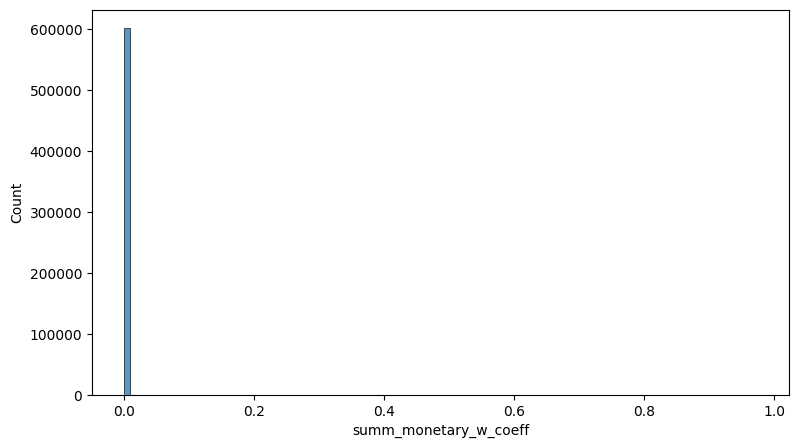

In [ ]:
plt.figure(figsize=(9,5))
sns.histplot(data=result_df_new, x="summ_monetary_w_coeff", bins=100)

<Axes: xlabel='summ_monetary_w_coeff', ylabel='Count'>

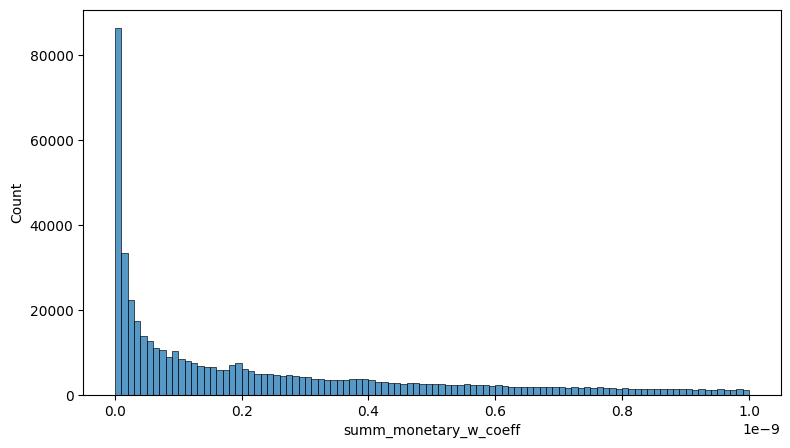

In [ ]:
plt.figure(figsize=(9,5))
sns.histplot(data=result_df_new[result_df_new['summ_monetary_w_coeff']< 0.000000001], x="summ_monetary_w_coeff", bins=100)

<Axes: xlabel='summ_monetary_w_coeff_log', ylabel='Count'>

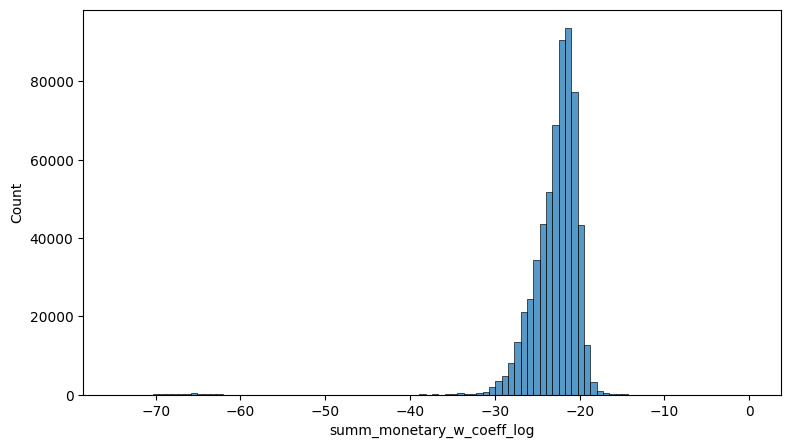

In [ ]:
result_df_new['summ_monetary_w_coeff_log'] = np.log(result_df_new['summ_monetary_w_coeff'])
plt.figure(figsize=(9,5))
sns.histplot(data=result_df_new, x="summ_monetary_w_coeff_log", bins=100)

<Axes: xlabel='summ_monetary_w_coeff_log', ylabel='Count'>

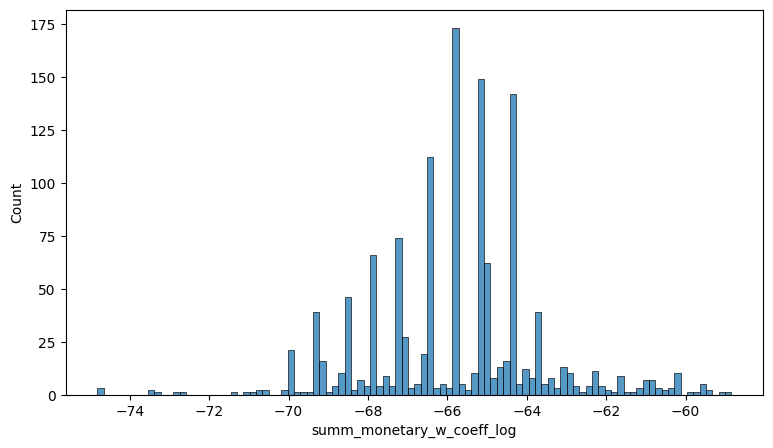

In [ ]:
result_df_new['summ_monetary_w_coeff_log'] = np.log(result_df_new['summ_monetary_w_coeff'])
plt.figure(figsize=(9,5))
sns.histplot(data=result_df_new[result_df_new['summ_monetary_w_coeff_log'] < -50], x="summ_monetary_w_coeff_log", bins=100)

<Axes: xlabel='summ_monetary_w_coeff_log'>

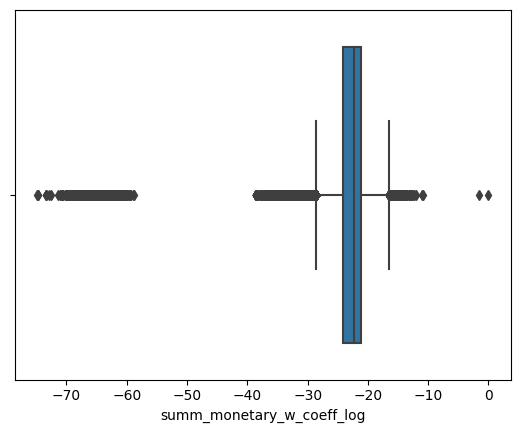

In [ ]:
sns.boxplot(x=result_df_new["summ_monetary_w_coeff_log"])

## Анализ фичи "transactions_count_w_coeff"



<Axes: xlabel='transactions_count_w_coeff', ylabel='Count'>

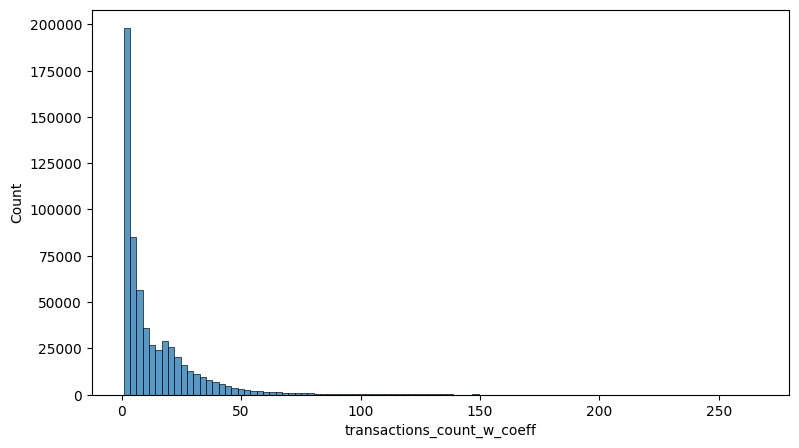

In [ ]:
plt.figure(figsize=(9,5))
sns.histplot(data=result_df_new, x="transactions_count_w_coeff", bins=100)

<Axes: xlabel='transactions_count_w_coeff_log', ylabel='Count'>

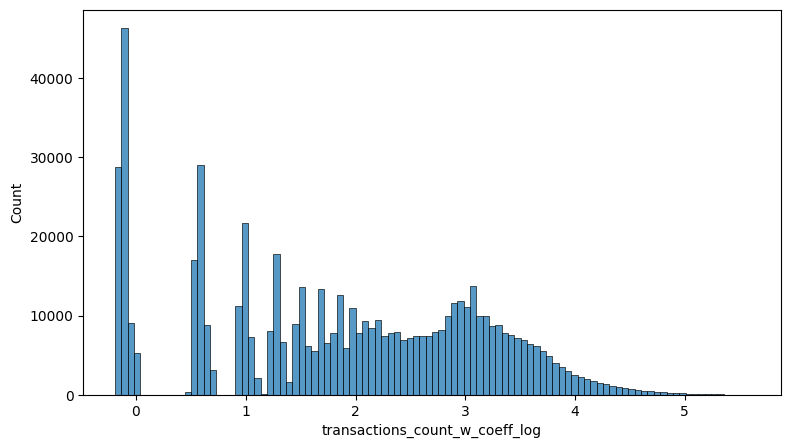

In [ ]:
result_df_new['transactions_count_w_coeff_log'] = np.log(result_df_new['transactions_count_w_coeff'])
plt.figure(figsize=(9,5))
sns.histplot(data=result_df_new, x="transactions_count_w_coeff_log", bins=100)

<Axes: xlabel='transactions_count_w_coeff_log'>

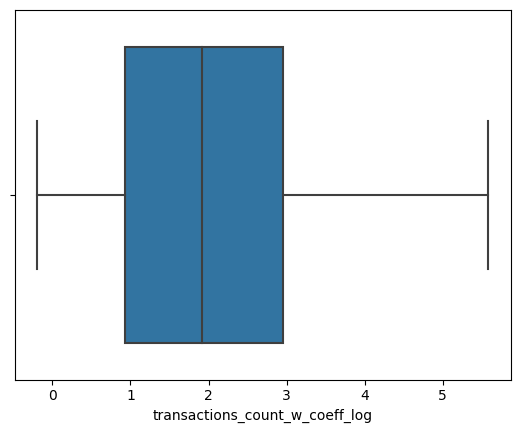

In [ ]:
sns.boxplot(x=result_df_new["transactions_count_w_coeff_log"])

<Axes: xlabel='trans_freq', ylabel='Count'>

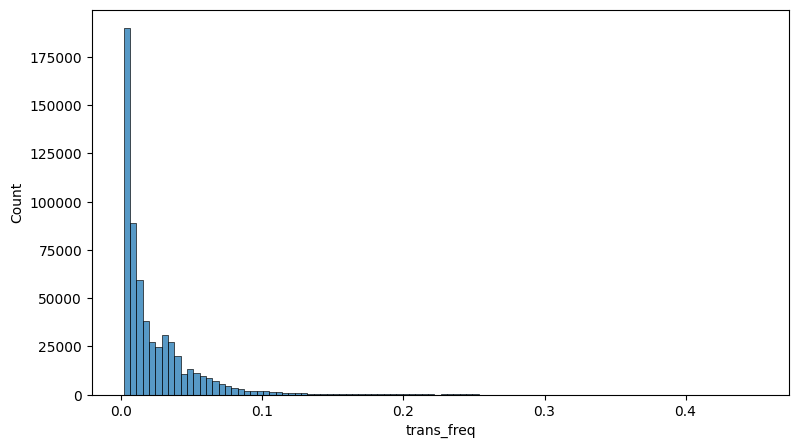

In [ ]:
plt.figure(figsize=(9,5))
sns.histplot(data=result_df_new, x="trans_freq", bins=100)

<Axes: xlabel='trans_freq_log', ylabel='Count'>

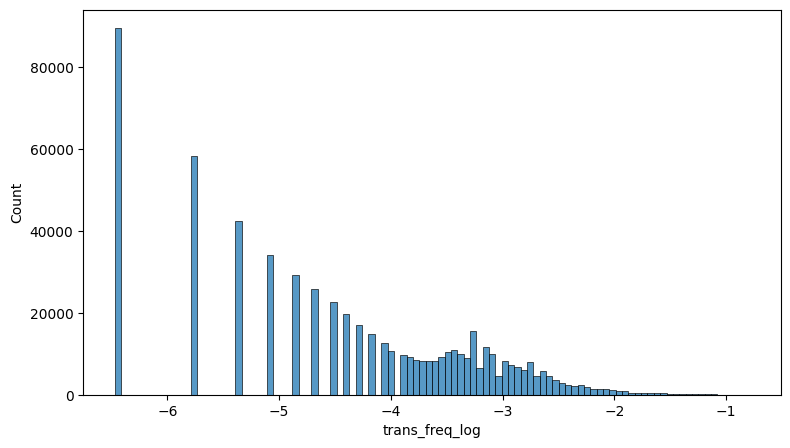

In [ ]:
result_df_new['trans_freq_log'] = np.log(result_df_new['trans_freq'])
plt.figure(figsize=(9,5))
sns.histplot(data=result_df_new, x="trans_freq_log", bins=100)

<Axes: xlabel='trans_freq_log'>

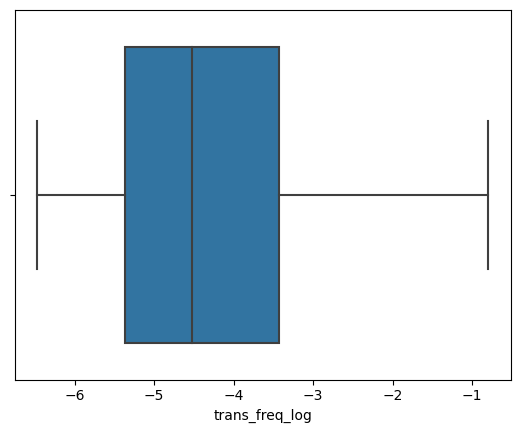

In [ ]:
sns.boxplot(x=result_df_new["trans_freq_log"])

## Анализ фичи "between_first_last"

<Axes: xlabel='between_first_last', ylabel='Count'>

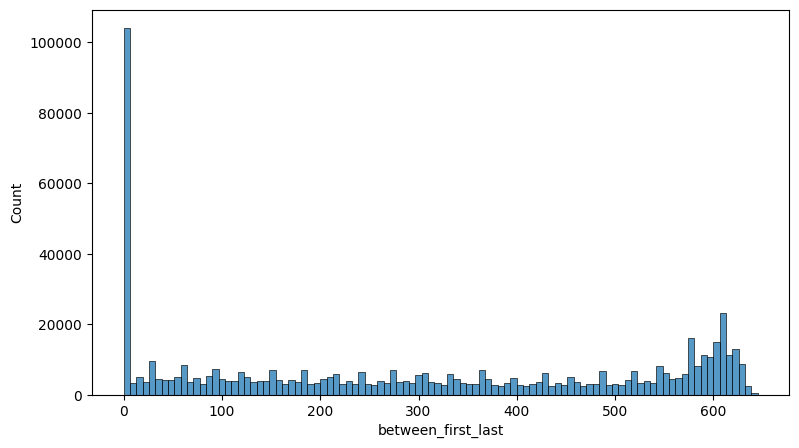

In [ ]:
plt.figure(figsize=(9,5))
sns.histplot(data=result_df_new, x="between_first_last", bins=100)

<Axes: xlabel='between_first_last_log', ylabel='Count'>

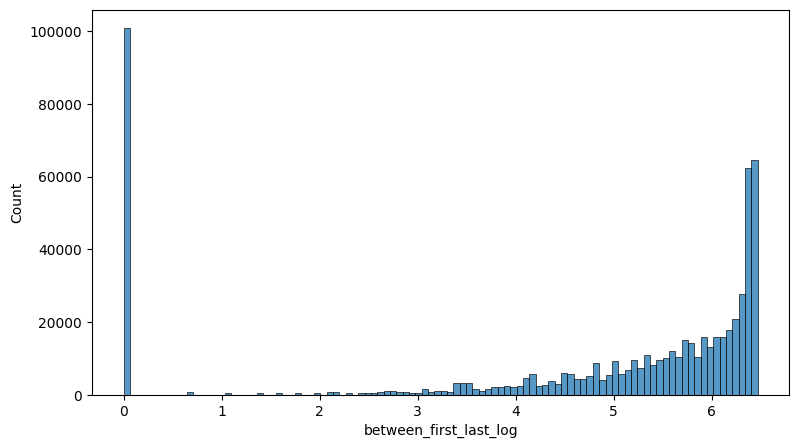

In [ ]:
result_df_new['between_first_last_log'] = np.log1p(result_df_new['between_first_last'])
plt.figure(figsize=(9,5))
sns.histplot(data=result_df_new, x="between_first_last_log", bins=100)

<Axes: xlabel='between_first_last', ylabel='Count'>

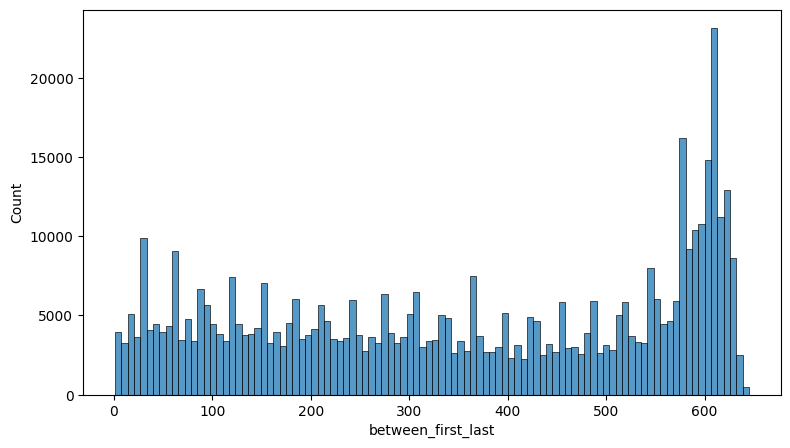

In [ ]:
plt.figure(figsize=(9,5))
sns.histplot(data=result_df_new[result_df_new["between_first_last"] > 0], x="between_first_last", bins=100)

<Axes: xlabel='between_first_last'>

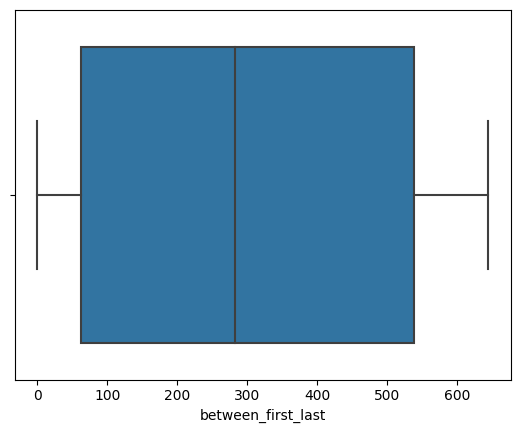

In [ ]:
sns.boxplot(x=result_df_new["between_first_last"])

In [ ]:
result_df_new['lifetime'] = result_df_new['between_first_last']/period
result_df_new

,partner,summ_monetary_w_coeff,transactions_count_w_coeff,between_first_last,between_last_today,trans_number,trans_freq,between_first_last_log,lifetime
partner,,,,,,,,,
0,0,1.974556e-08,39.400,609,11,43,0.066667,6.413459,0.944186
1,1,1.532605e-08,42.625,622,10,47,0.072868,6.434547,0.964341
2,2,8.078543e-10,32.950,546,37,36,0.055814,6.304449,0.846512
3,3,6.469110e-08,2.725,490,65,3,0.004651,6.196444,0.759690
4,4,1.194659e-08,119.850,632,11,134,0.207752,6.450470,0.979845
...,...,...,...,...,...,...,...,...,...
817340,1695375,6.009388e-12,7.425,599,34,8,0.012403,6.396930,0.928682
817341,1695377,2.376254e-12,1.925,416,156,2,0.003101,6.033086,0.644961
817342,1695379,1.172750e-11,3.775,158,281,4,0.006202,5.068904,0.244961


<Axes: xlabel='lifetime', ylabel='Count'>

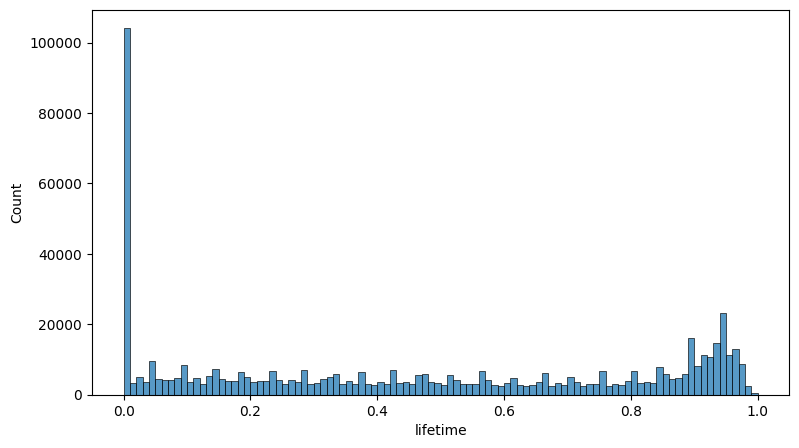

In [ ]:
plt.figure(figsize=(9,5))
sns.histplot(data=result_df_new, x="lifetime", bins=100)

In [ ]:
result_df_new.describe()

,partner,summ_monetary_w_coeff,transactions_count_w_coeff,between_first_last,between_last_today,trans_number,trans_freq,between_first_last_log,lifetime
count,6.014060e+05,6.014060e+05,601406.000000,601406.000000,601406.000000,601406.000000,601406.000000,601406.000000,601406.000000
mean,5.694484e+05,1.975948e-06,13.132526,296.302724,182.778687,14.334895,0.022225,4.640726,0.459384
std,3.176035e+05,1.286846e-03,16.370676,228.763907,188.354205,17.784846,0.027573,2.260768,0.354673
min,0.000000e+00,3.218354e-33,0.825000,0.000000,0.000000,1.000000,0.001550,0.000000,0.000000
25%,3.026265e+05,3.478605e-11,2.550000,63.000000,18.000000,3.000000,0.004651,4.158883,0.097674
50%,5.760975e+05,2.075786e-10,6.800000,283.000000,94.000000,7.000000,0.010853,5.648974,0.438760
75%,8.392168e+05,7.066338e-10,19.250000,539.000000,332.000000,21.000000,0.032558,6.291569,0.835659
max,1.695381e+06,9.750000e-01,266.225000,645.000000,644.000000,291.000000,0.451163,6.470800,1.000000


<Axes: xlabel='between_last_today', ylabel='Count'>

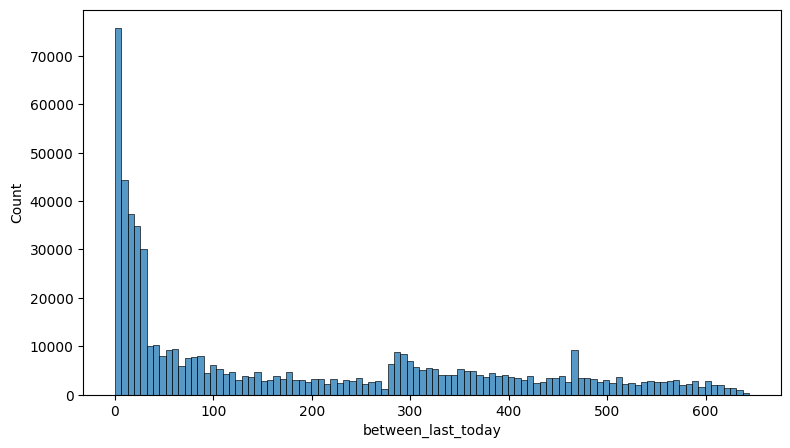

In [ ]:
plt.figure(figsize=(9,5))
sns.histplot(data=result_df_new, x="between_last_today", bins=100)

<Axes: xlabel='between_last_today_log', ylabel='Count'>

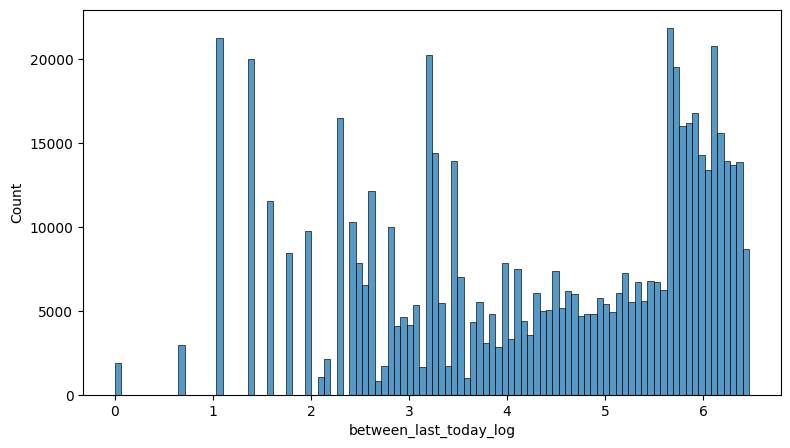

In [ ]:
result_df_new['between_last_today_log'] = np.log1p(result_df_new['between_last_today'])
plt.figure(figsize=(9,5))
sns.histplot(data=result_df_new, x="between_last_today_log", bins=100)

In [ ]:
import plotly.express as px
fig = px.histogram(result_df_new, x="between_last_today_log")
fig.show()

<Axes: xlabel='between_last_today_log'>

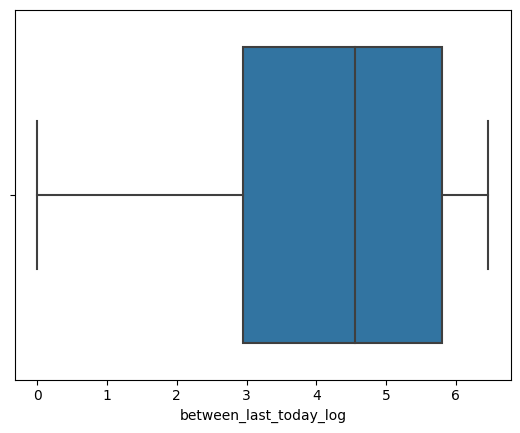

In [ ]:
sns.boxplot(x=result_df_new["between_last_today_log"])

# Связь между признаками

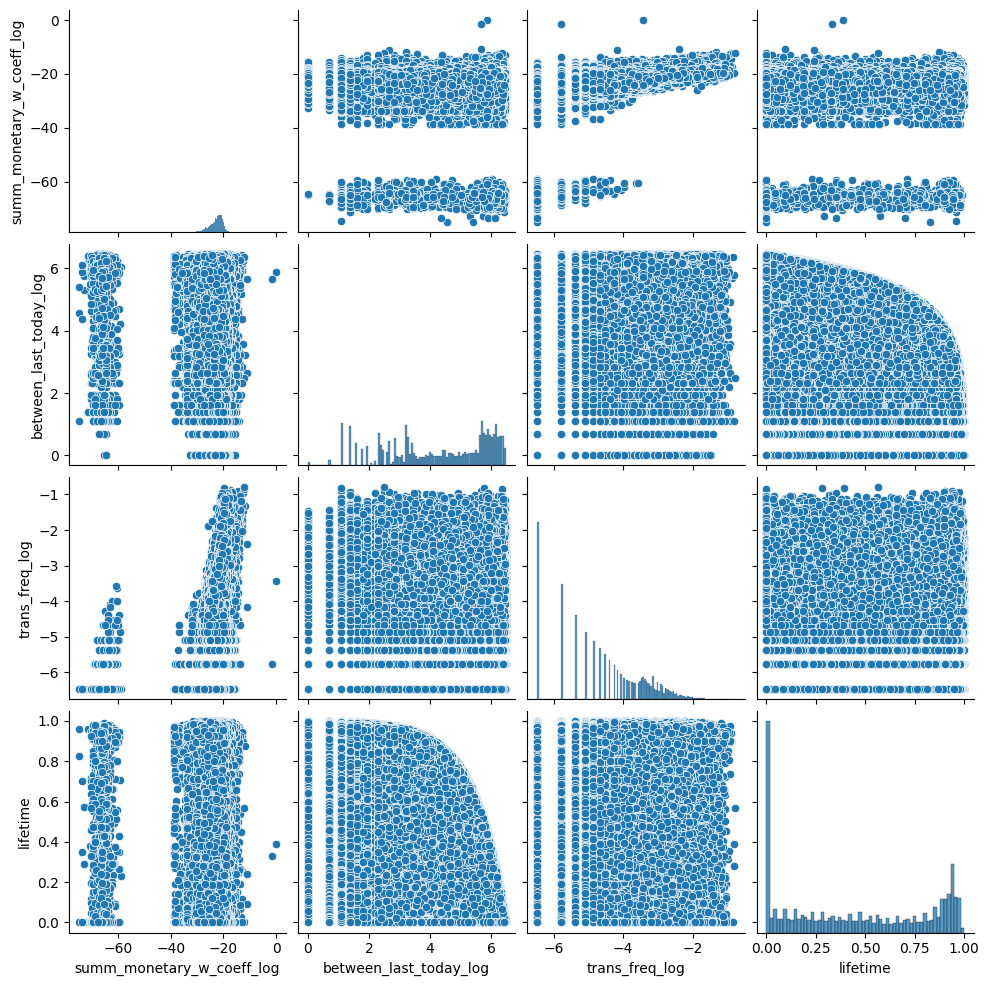

In [ ]:
sns.pairplot(data = result_df_new[['summ_monetary_w_coeff_log', 'between_last_today_log', 'trans_freq_log', 'lifetime']])

In [ ]:
result_df_new

,partner,summ_monetary_w_coeff,transactions_count_w_coeff,between_first_last,between_last_today,trans_number,trans_freq,between_first_last_log,lifetime,between_last_today_log,trans_freq_log,summ_monetary_w_coeff_log,transactions_count_w_coeff_log
partner,,,,,,,,,,,,,
0,0,1.974556e-08,39.400,609,11,43,0.066667,6.413459,0.944186,2.484907,-2.708050,-17.740337,3.673766
1,1,1.532605e-08,42.625,622,10,47,0.072868,6.434547,0.964341,2.397895,-2.619103,-17.993712,3.752441
2,2,8.078543e-10,32.950,546,37,36,0.055814,6.304449,0.846512,3.637586,-2.885731,-20.936639,3.494991
3,3,6.469110e-08,2.725,490,65,3,0.004651,6.196444,0.759690,4.189655,-5.370638,-16.553642,1.002468
4,4,1.194659e-08,119.850,632,11,134,0.207752,6.450470,0.979845,2.484907,-1.571411,-18.242820,4.786241
...,...,...,...,...,...,...,...,...,...,...,...,...,...
817340,1695375,6.009388e-12,7.425,599,34,8,0.012403,6.396930,0.928682,3.555348,-4.389809,-25.837698,2.004853
817341,1695377,2.376254e-12,1.925,416,156,2,0.003101,6.033086,0.644961,5.056246,-5.776103,-26.765496,0.654926
817342,1695379,1.172750e-11,3.775,158,281,4,0.006202,5.068904,0.244961,5.641907,-5.082956,-25.169084,1.328400


In [ ]:
cm = sns.color_palette("vlag", as_cmap=True)
data_num=result_df_new[['summ_monetary_w_coeff_log', 'between_last_today_log', 'trans_freq_log', 'lifetime']]
data_num.corr().style.background_gradient(cmap=cm, vmin = -1, vmax=1)

,summ_monetary_w_coeff_log,between_last_today_log,trans_freq_log,lifetime
summ_monetary_w_coeff_log,1.000000,-0.010995,0.462929,0.039516
between_last_today_log,-0.010995,1.000000,-0.011272,-0.666286
trans_freq_log,0.462929,-0.011272,1.000000,0.041505
lifetime,0.039516,-0.666286,0.041505,1.000000


In [ ]:
import plotly.express as px
fig = px.scatter(result_df_new, x="summ_monetary_w_coeff_log", y="between_last_today_log")
fig.show(renderer="jpeg")

ValueError: ignored

In [ ]:
result_df_new.loc[
    (result_df_new['summ_monetary_w_coeff_log'] < -40)&
    (result_df_new['between_last_today_log'] < 3.5),
    'sector'] = 1
result_df_new.loc[
    (result_df_new['summ_monetary_w_coeff_log'] < -40)&
    (result_df_new['between_last_today_log'] >= 3.5)&
    (result_df_new['between_last_today_log'] < 6),
    'sector'] = 2
result_df_new.loc[
    (result_df_new['summ_monetary_w_coeff_log'] < -40)&
    (result_df_new['between_last_today_log'] >= 6),
    'sector'] = 3

result_df_new.loc[
    (result_df_new['summ_monetary_w_coeff_log'] >= -40)&
    (result_df_new['summ_monetary_w_coeff_log'] < -25)&
    (result_df_new['between_last_today_log'] < 3.5),
    'sector'] = 4
result_df_new.loc[
    (result_df_new['summ_monetary_w_coeff_log'] >= -40)&
    (result_df_new['summ_monetary_w_coeff_log'] < -25)&
    (result_df_new['between_last_today_log'] >= 3.5)&
    (result_df_new['between_last_today_log'] < 6),
    'sector'] = 5
result_df_new.loc[
    (result_df_new['summ_monetary_w_coeff_log'] >= -40)&
    (result_df_new['summ_monetary_w_coeff_log'] < -25)&
    (result_df_new['between_last_today_log'] >= 6),
    'sector'] = 6

result_df_new.loc[
    (result_df_new['summ_monetary_w_coeff_log'] >= -25)&
    (result_df_new['summ_monetary_w_coeff_log'] < -20)&
    (result_df_new['between_last_today_log'] < 3.5),
    'sector'] = 7
result_df_new.loc[
    (result_df_new['summ_monetary_w_coeff_log'] >= -25)&
    (result_df_new['summ_monetary_w_coeff_log'] < -20)&
    (result_df_new['between_last_today_log'] >= 3.5)&
    (result_df_new['between_last_today_log'] < 6),
    'sector'] = 8
result_df_new.loc[
    (result_df_new['summ_monetary_w_coeff_log'] >= -25)&
    (result_df_new['summ_monetary_w_coeff_log'] < -20)&
    (result_df_new['between_last_today_log'] >= 3.5)&
    (result_df_new['between_last_today_log'] >= 6),
    'sector'] = 9


result_df_new.loc[
    (result_df_new['summ_monetary_w_coeff_log'] >= -20)&
    (result_df_new['between_last_today_log'] < 3.5),
    'sector'] = 10
result_df_new.loc[
    (result_df_new['summ_monetary_w_coeff_log'] >= -20)&
    (result_df_new['between_last_today_log'] > 3.5)&
    (result_df_new['between_last_today_log'] < 6),
    'sector'] = 11
result_df_new.loc[
    (result_df_new['summ_monetary_w_coeff_log'] >= -20)&
    (result_df_new['between_last_today_log'] >= 3.5)&
    (result_df_new['between_last_today_log'] >= 6),
    'sector'] = 12

In [ ]:
result_df_new

,partner,summ_monetary_w_coeff,transactions_count_w_coeff,between_first_last,between_last_today,trans_number,trans_freq,between_first_last_log,lifetime,between_last_today_log,trans_freq_log,summ_monetary_w_coeff_log,transactions_count_w_coeff_log,sector
partner,,,,,,,,,,,,,,
0,0,1.974556e-08,39.400,609,11,43,0.066667,6.413459,0.944186,2.484907,-2.708050,-17.740337,3.673766,10.0
1,1,1.532605e-08,42.625,622,10,47,0.072868,6.434547,0.964341,2.397895,-2.619103,-17.993712,3.752441,10.0
2,2,8.078543e-10,32.950,546,37,36,0.055814,6.304449,0.846512,3.637586,-2.885731,-20.936639,3.494991,8.0
3,3,6.469110e-08,2.725,490,65,3,0.004651,6.196444,0.759690,4.189655,-5.370638,-16.553642,1.002468,11.0
4,4,1.194659e-08,119.850,632,11,134,0.207752,6.450470,0.979845,2.484907,-1.571411,-18.242820,4.786241,10.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
817340,1695375,6.009388e-12,7.425,599,34,8,0.012403,6.396930,0.928682,3.555348,-4.389809,-25.837698,2.004853,5.0
817341,1695377,2.376254e-12,1.925,416,156,2,0.003101,6.033086,0.644961,5.056246,-5.776103,-26.765496,0.654926,5.0
817342,1695379,1.172750e-11,3.775,158,281,4,0.006202,5.068904,0.244961,5.641907,-5.082956,-25.169084,1.328400,5.0


In [ ]:
import plotly.express as px
fig = px.scatter(result_df_new, x="summ_monetary_w_coeff_log", y="between_last_today_log", color="sector")
fig.show(renderer="jpeg")

ValueError: ignored

In [ ]:
result_df_new['sector'].value_counts()

8.0     209933
7.0     169309
9.0      77989
5.0      45616
4.0      35806
11.0     19573
6.0      17823
10.0     16788
12.0      7298
2.0        549
1.0        496
3.0        226
Name: sector, dtype: int64

<Axes: ylabel='sector'>

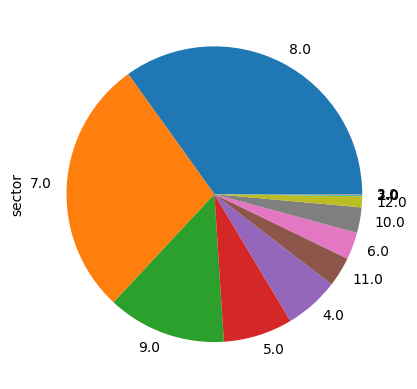

In [ ]:
result_df_new['sector'].value_counts().plot(kind='pie')

In [ ]:
sector_diff = pd.merge(result_df[['partner','sector']].reset_index(), result_df_new[['partner','sector']].reset_index(), on = ['partner'], how = 'inner', suffixes = ('_rdf', '_rdfn') )

ValueError: ignored